<a href="https://colab.research.google.com/github/jaimie-r/parking-env-model-predictive-control/blob/main/improvedParkingv0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
print(torch.cuda.is_available())

True


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [ ]:
# --- Fix NumPy and PyTorch Compatibility ---
!pip install docopt

# --- Install dev branch of highway-env ---
!pip install --user git+https://github.com/eleurent/highway-env

# Fix sys.path to include --user installs
import sys
sys.path.append("/root/.local/lib/python3.11/site-packages")


# --- Fix NumPy and PyTorch Compatibility ---
!pip install docopt

# --- Install dev branch of highway-env ---
!pip install --user git+https://github.com/eleurent/highway-env

# Fix sys.path to include --user installs
import sys
sys.path.append("/root/.local/lib/python3.11/site-packages")

# --- Clone rl-agents repo ---
%cd /content
%rm -rf /content/rl-agents
!git clone https://github.com/eleurent/rl-agents.git

# --- Patch logger.py and evaluation.py ---
from pathlib import Path

# Patch logger.py

logger_path = Path("/content/rl-agents/rl_agents/trainer/logger.py")
logger_text = logger_path.read_text()
# Replace default argument value
logger_text = logger_text.replace("gym_level=gym.logger.INFO", "gym_level=__import__('logging').INFO")
# Remove any line that tries to set the gym logger level
logger_lines = logger_text.splitlines()
logger_lines = [line for line in logger_lines if "gym.logger.set" not in line]
# Write back the patched file
logger_path.write_text("\n".join(logger_lines))

# Patch evaluation.py: remove broken import and define capped_cubic_video_schedule
eval_path = Path("/content/rl-agents/rl_agents/trainer/evaluation.py")
eval_text = eval_path.read_text()


eval_text = eval_text.replace("np.infty", "np.inf")
eval_text = eval_text.replace(
    "from gymnasium.wrappers import RecordVideo, RecordEpisodeStatistics, capped_cubic_video_schedule",
    "from gymnasium.wrappers import RecordVideo, RecordEpisodeStatistics"
)

inject_fn = """
def capped_cubic_video_schedule(episode_id):
    return True
"""

eval_lines = eval_text.splitlines()
for i, line in enumerate(eval_lines):
    if not line.strip().startswith("import") and not line.strip().startswith("from"):
        inject_index = i
        break
eval_lines = eval_lines[:inject_index] + [inject_fn.strip()] + eval_lines[inject_index:]
eval_path.write_text("\n".join(eval_lines))

import gymnasium as gym
import highway_env

import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from collections import namedtuple

# Visualization
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.notebook import trange

# IO
from pathlib import Path

import sys
from tqdm.notebook import trange
!pip install tensorboardx gym pyvirtualdisplay
!apt-get install -y xvfb ffmpeg

%cd /content
!git clone https://github.com/Farama-Foundation/HighwayEnv.git 2> /dev/null
%cd /content/HighwayEnv/scripts/

from utils import record_videos, show_videos

import sys
from tqdm.notebook import trange
!pip install tensorboardx gym pyvirtualdisplay
!apt-get install -y xvfb ffmpeg

%cd /content
!git clone https://github.com/Farama-Foundation/HighwayEnv.git 2> /dev/null

# Now safe to import with patch applied
%cd /content/HighwayEnv/scripts/
from utils import record_videos, show_videos



  Cloning https://github.com/eleurent/highway-env to /tmp/pip-req-build-3g6t1dhw
  Running command git clone --filter=blob:none --quiet https://github.com/eleurent/highway-env /tmp/pip-req-build-3g6t1dhw
  Resolved https://github.com/eleurent/highway-env to commit c7c12cc30bd5a255cb846d7f7a875589bbf3684e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Cloning https://github.com/eleurent/highway-env to /tmp/pip-req-build-z2muwa1k
  Running command git clone --filter=blob:none --quiet https://github.com/eleurent/highway-env /tmp/pip-req-build-z2muwa1k
  Resolved https://github.com/eleurent/highway-env to commit c7c12cc30bd5a255cb846d7f7a875589bbf3684e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
/content
Cloning into 'rl-agents'...
remote: Enumerating objects: 6735, done.
remote: Counting objects: 100% (118/118)

In [ ]:

Transition = namedtuple('Transition', ['state', 'action', 'next_state'])

def collect_interaction_data(env, size=1000, action_repeat=2, noise_std=0.01):
    data, done = [], True
    for _ in trange(size, desc="Collecting interaction data"):
        action = env.action_space.sample()
        for _ in range(action_repeat):
            if done:
              previous_obs, info = env.reset()
            obs, reward, done, truncated, info = env.step(action)
            # Add Gaussian noise to observations
            noisy_state = torch.Tensor(previous_obs["observation"]) + noise_std * torch.randn_like(torch.Tensor(previous_obs["observation"]))
            noisy_next_state = torch.Tensor(obs["observation"]) + noise_std * torch.randn_like(torch.Tensor(obs["observation"]))

            data.append(Transition(
                noisy_state,
                torch.Tensor(action),
                noisy_next_state
            ))
            previous_obs = obs

    return data

env = gym.make("parking-v0", render_mode="rgb_array")
env = record_videos(env)
data = collect_interaction_data(env, noise_std=0.003)
print("Sample transition:", data[0])



/usr/local/lib/python3.11/dist-packages/gymnasium/wrappers/rendering.py:283: UserWarning: WARN: Overwriting existing videos at /content/HighwayEnv/scripts/videos folder (try specifying a different `video_folder` for the `RecordVideo` wrapper if this is not desired)
  logger.warn(


Sample transition: Transition(state=tensor([ 0.0012,  0.0010, -0.0020,  0.0013, -0.6685,  0.7347]), action=tensor([-0.1665,  0.3777]), next_state=tensor([ 0.0071, -0.0048,  0.0257, -0.0226, -0.6713,  0.7379]))


Train dynamics:   0%|          | 0/1500 [00:00<?, ?it/s]

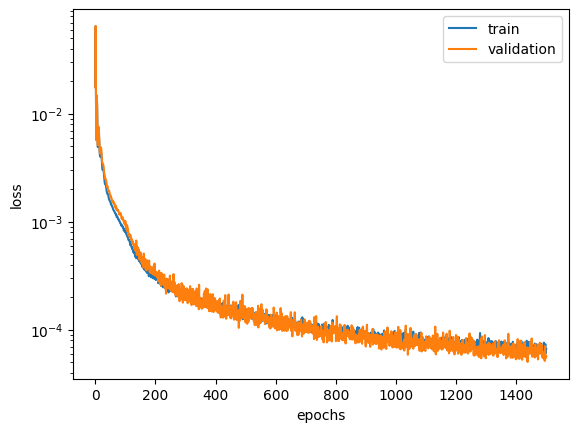

In [ ]:

class ResidualBlock(nn.Module):
    def __init__(self, size, dropout_prob=0.1):
        super().__init__()
        self.linear1 = nn.Linear(size, size)
        self.norm1 = nn.LayerNorm(size)
        self.dropout1 = nn.Dropout(dropout_prob)

        self.linear2 = nn.Linear(size, size)
        self.norm2 = nn.LayerNorm(size)
        self.dropout2 = nn.Dropout(dropout_prob)

    def forward(self, x):
        residual = x
        x = self.dropout1(F.relu(self.norm1(self.linear1(x))))
        x = self.dropout2(F.relu(self.norm2(self.linear2(x))))
        return x + residual  # Residual connection

class DynamicsModel(nn.Module):
    def __init__(self, state_size, action_size, hidden_size=128, dt=0.1, dropout_prob=0.1):
        super().__init__()
        self.dt = dt
        self.state_size = state_size
        self.action_size = action_size

        self.input_layer = nn.Linear(state_size + action_size, hidden_size)
        self.res_block1 = ResidualBlock(hidden_size, dropout_prob)
        self.res_block2 = ResidualBlock(hidden_size, dropout_prob)
        self.output_layer = nn.Linear(hidden_size, state_size)

    def forward(self, x, u):
        xu = torch.cat((x, u), dim=-1)
        xh = F.relu(self.input_layer(xu))
        xh = self.res_block1(xh)
        xh = self.res_block2(xh)
        dx = self.output_layer(xh)
        return x + dx * self.dt


dynamics = DynamicsModel(state_size=env.observation_space.spaces["observation"].shape[0],
                         action_size=env.action_space.shape[0],
                         hidden_size=64,
                         dt=1/env.unwrapped.config["policy_frequency"]).to(device)


optimizer = torch.optim.Adam(dynamics.parameters(), lr=0.01)

# Split dataset into training and validation
train_ratio = 0.7
train_data, validation_data = data[:int(train_ratio * len(data))], data[int(train_ratio * len(data)):]

def compute_loss(model, data_t, loss_func = torch.nn.MSELoss(), noise_std=0.0):
    states, actions, next_states = data_t
    states = states.to(device)
    actions = actions.to(device)
    next_states = next_states.to(device)
    if noise_std > 0:
        states = states + noise_std * torch.randn_like(states)
        actions = actions + noise_std * torch.randn_like(actions)
    predictions = model(states, actions)
    return loss_func(predictions, next_states)

def transpose_batch(batch):
    return Transition(*map(torch.stack, zip(*batch)))

def train(model, train_data, validation_data, epochs=1500, noise_std=0.0):
    train_data_t = transpose_batch(train_data)
    validation_data_t = transpose_batch(validation_data)
    losses = np.full((epochs, 2), np.nan)
    for epoch in trange(epochs, desc="Train dynamics"):
        # Compute loss gradient and step optimizer
        loss = compute_loss(model, train_data_t, noise_std=noise_std)
        validation_loss = compute_loss(model, validation_data_t)
        losses[epoch] = [loss.detach().cpu().numpy(), validation_loss.detach().cpu().numpy()]
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    # Plot losses
    plt.plot(losses)
    plt.yscale("log")
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend(["train", "validation"])
    plt.show()

train(dynamics, data, validation_data, noise_std=0.003)



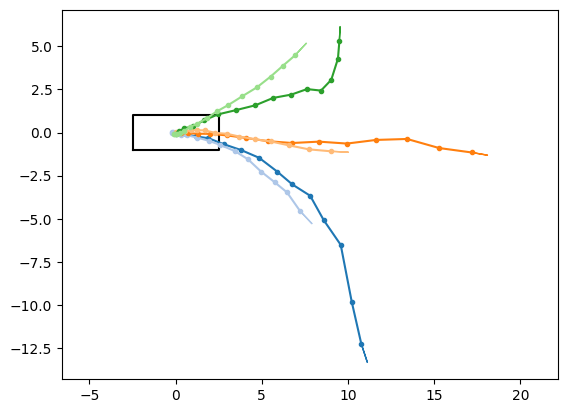

Reward of a sample transition: tensor([-0.4627])


Testing 5 episodes...:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
def predict_trajectory(state, actions, model, action_repeat=1):
    state = state.to(device)
    actions = actions.to(device)
    states = []
    for action in actions:
        for _ in range(action_repeat):
            state = model(state, action)
            states.append(state)
    return torch.stack(states, dim=0)

def plot_trajectory(states, color):
    scales = np.array(env.unwrapped.config["observation"]["scales"])
    states = np.clip(states.squeeze(1).detach().cpu().numpy() * scales, -100, 100)
    plt.plot(states[:, 0], states[:, 1], color=color, marker='.')
    plt.arrow(states[-1,0], states[-1,1], states[-1,4]*1, states[-1,5]*1, color=color)

def visualize_trajectories(model, state, horizon=15):
    plt.cla()
    # Draw a car
    plt.plot(state.numpy()[0]+2.5*np.array([-1, -1, 1, 1, -1]),
             state.numpy()[1]+1.0*np.array([-1, 1, 1, -1, -1]), 'k')
    # Draw trajectories
    state = state.unsqueeze(0)
    colors = iter(plt.get_cmap("tab20").colors)
    # Generate commands
    for steering in np.linspace(-0.5, 0.5, 3):
        for acceleration in np.linspace(0.8, 0.4, 2):
            actions = torch.Tensor([acceleration, steering]).view(1,1,-1)
            # Predict trajectories
            states = predict_trajectory(state, actions, model, action_repeat=horizon)
            plot_trajectory(states, color=next(colors))
    plt.axis("equal")
    plt.show()

visualize_trajectories(dynamics, state=torch.Tensor([0, 0, 0, 0, 1, 0]))

def reward_model(states, goal, gamma=None):
    """
        The reward is a weighted L1-norm between the state and a goal
    :param Tensor states: a batch of states. shape: [batch_size, state_size].
    :param Tensor goal: a goal state. shape: [state_size].
    :param float gamma: a discount factor
    """
    goal = goal.expand(states.shape)
    reward_weigths = torch.Tensor(env.unwrapped.config["reward_weights"]).to(states.device)
    rewards = -torch.pow(torch.norm((states-goal)*reward_weigths, p=1, dim=-1), 0.5)
    if gamma:
        time = torch.arange(rewards.shape[0], dtype=torch.float).unsqueeze(-1).expand(rewards.shape).to(states.device)
        rewards *= torch.pow(gamma, time)
    return rewards

obs, info = env.reset()
print("Reward of a sample transition:", reward_model(torch.Tensor(obs["observation"]).unsqueeze(0),
                                                     torch.Tensor(obs["desired_goal"])))


def cem_planner(state, goal, action_size, horizon=5, population=20, selection=5,
                iterations=2, num_repeats=2, noise_std=0.01):
    """
    Cross-Entropy Method planner with robust evaluation:
    Simulate each candidate action sequence from multiple noisy initial states.
    """
    action_mean = torch.zeros(horizon, 1, action_size)
    action_std = torch.ones(horizon, 1, action_size)

    for _ in range(iterations):
        # Sample action sequences: [horizon, population, action_size]
        actions = torch.normal(
            mean=action_mean.repeat(1, population, 1),
            std=action_std.repeat(1, population, 1)
        )
        actions = torch.clamp(
            actions,
            min=env.action_space.low.min(),
            max=env.action_space.high.max()
        )

        state_batch = state.expand(population, -1)
        predicted_states = predict_trajectory(state_batch, actions, dynamics, action_repeat=5)

        # Repeat each sequence from multiple noisy initial states
        rewards = []
        for _ in range(num_repeats):
            '''
            noisy_states = state.expand(population, -1) + noise_std * torch.randn_like(state.expand(population, -1))
            this_reward = reward_model(predicted_states, goal).sum(dim=0)  # [population]
            rewards.append(this_reward)
            '''

            noisy_states = state_batch + noise_std * torch.randn_like(state_batch)
            noise = noise_std * torch.randn_like(state_batch)
            this_reward = reward_model(predicted_states + noise.unsqueeze(0), goal).sum(dim=0)  # [population]
            rewards.append(this_reward)

        # Stack all repeats: [num_repeats, population]
        reward_stack = torch.stack(rewards)

        # Option 1: Average reward across noisy repeats
        robust_returns = reward_stack.mean(dim=0)

        # Option 2 (optional): Worst-case reward
        # robust_returns = reward_stack.min(dim=0).values

        # Select top-k action sequences
        _, best = robust_returns.topk(selection, largest=True, sorted=False)
        best_actions = actions[:, best.to(actions.device), :]  # [horizon, selection, action_size]

        # Update the distribution
        action_mean = best_actions.mean(dim=1, keepdim=True)
        action_std = best_actions.std(dim=1, unbiased=False, keepdim=True)

    return action_mean[0].squeeze(dim=0)

obs, info = env.reset()

# attempted to run more episodes, takes a really long time, got up to 200
num_episodes = 5
episode_rewards = []

for episode in trange(num_episodes, desc=f"Testing {num_episodes} episodes..."):
    obs, info = env.reset()
    total_reward = 0

    done, truncated = False, False
    while not (done or truncated):
        # print(type(obs), obs)
        with torch.no_grad():
            action = cem_planner(torch.Tensor(obs["observation"]).to(device),
                     torch.Tensor(obs["desired_goal"]).to(device),
                     env.action_space.shape[0])
        if action is None:
            break
        obs, reward, done, truncated, info = env.step(action.numpy())
        total_reward += reward

    episode_rewards.append(total_reward)

env.close()
show_videos()
